In [1]:
%pip install opencv-python
%pip install numpy
%pip install matplotlib

Best match value: 0.6283653974533081 at scale: 1.2105263157894737


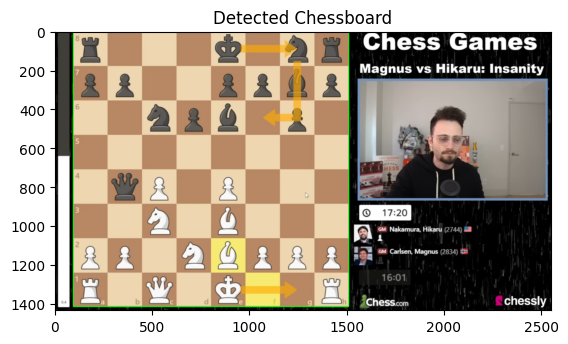

In [2]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

# Load images
BOARD_TEMPLATE = cv2.imread('chessboard.png', cv2.IMREAD_COLOR)

def load_images(test_image_path, template_image_path):
    test_image = cv2.imread(test_image_path, cv2.IMREAD_COLOR)
    template = cv2.imread(template_image_path, cv2.IMREAD_COLOR)
    return test_image, template

def convert_to_grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

def match_template(test_gray, template_gray, scale_range, threshold=0.5):
    template_h, template_w = template_gray.shape[:2]
    found = None

    # Loop over scales
    for scale in scale_range:
        # Resize the template according to the current scale
        resized_template = cv2.resize(template_gray, None, fx=scale, fy=scale, interpolation=cv2.INTER_AREA)

        # Skip scales where the template is larger than the test image
        if resized_template.shape[0] > test_gray.shape[0] or resized_template.shape[1] > test_gray.shape[1]:
            continue

        # Template Matching using cv2.matchTemplate
        result = cv2.matchTemplate(test_gray, resized_template, cv2.TM_CCOEFF_NORMED)

        # Get the maximum correlation value and its location
        min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(result)

        # Apply threshold to filter out bad matches
        if max_val > threshold:
            # Save the best match found so far
            if found is None or max_val > found[0]:
                found = (max_val, max_loc, scale)

    return found

def visualize_detection(test_image_path, template, found):
    if not found:
        print("No match found")
        return

    (max_val, max_loc, best_scale) = found
    print(f"Best match value: {max_val} at scale: {best_scale}")

    # Reload the test image to reset any drawings from previous runs
    test_image = cv2.imread(test_image_path, cv2.IMREAD_COLOR)

    # Resize the template to the best scale
    best_template = cv2.resize(template, None, fx=best_scale, fy=best_scale, interpolation=cv2.INTER_AREA)

    # Draw a rectangle around the detected area in the test image
    (top_left_x, top_left_y) = max_loc
    bottom_right_x = top_left_x + best_template.shape[1]
    bottom_right_y = top_left_y + best_template.shape[0]

    cv2.rectangle(test_image, (top_left_x, top_left_y), (bottom_right_x, bottom_right_y), (0, 255, 0), 3)

    # Display the result
    plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))
    plt.title('Detected Chessboard')
    plt.show()

def main():
    # Load images
    test_image_path = 'test_image.png'
    template_image_path = 'chessboard.png'
    test_image, template = load_images(test_image_path, template_image_path)

    # Convert both images to grayscale
    test_gray = convert_to_grayscale(test_image)
    template_gray = convert_to_grayscale(template)

    # Multi-scale template matching
    scale_range = np.linspace(0.5, 2, 20)  # Narrow down the scale range
    threshold = 0.5  # Threshold for match quality
    found = match_template(test_gray, template_gray, scale_range, threshold)

    # Visualize the detected chessboard
    visualize_detection(test_image_path, template, found)

if __name__ == "__main__":
    main()


In [3]:
%pip install yt-dlp


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 171.6/171.6 kB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 24.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 164.1/164.1 kB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 25.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.4/194.4 kB 8.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 23.7 MB/s eta 0:00:00


In [4]:
import os
import subprocess
import sys

VIDEO_DOWNLOAD_FOLDER = "DownloadedVideos"

# Define a function to run a shell command and capture the output
def run_command(command):
    try:
        result = subprocess.run(command, stdout=subprocess.PIPE, stderr=subprocess.PIPE, text=True, shell=True)
        return result.stdout, result.stderr
    except Exception as e:
        print(f"Error running command: {e}")
        sys.exit(1)

# Function to download the video using yt-dlp
def download_video(video_url, output_file="output.mp4"):
    print("Starting video download using yt-dlp...")

    # Set yt-dlp command to download video in 720p quality
    os.makedirs(VIDEO_DOWNLOAD_FOLDER, exist_ok=True)
    output_path = os.path.join(VIDEO_DOWNLOAD_FOLDER, output_file)

    command = f"yt-dlp -f 'bestvideo[height<=720]+bestaudio/best[height<=720]' --merge-output-format mp4 -o {output_path} {video_url}"
    stdout, stderr = run_command(command)

    if "error" in stderr.lower():
        print("An error occurred while downloading the video:")
        print(stderr)
    else:
        print("Video download completed successfully.")
        print(stderr)

    return output_file

# Function to get video information
def get_video_info(file_path):
    print("Getting video information...")

    # Use ffprobe to get video information
    command = f"ffprobe -v quiet -print_format json -show_format -show_streams {file_path}"
    stdout, stderr = run_command(command)

    if stdout:
        print(stdout)
    else:
        print("Error getting video information:")
        print(stderr)

urls = [
    "https://www.youtube.com/watch?v=wYCYWpx3CFM",
    "https://www.youtube.com/watch?v=u0o38cEaGdw",
    "https://www.youtube.com/watch?v=Uc7Kf_-hsgw",
    "https://www.youtube.com/watch?v=65VWIFlc4C4",
    "https://www.youtube.com/watch?v=NFod-ozimmM",
    "https://www.youtube.com/watch?v=-ZVbDR3sRRo",
    "https://www.youtube.com/watch?v=9dQzTnvsNG4",
    "https://www.youtube.com/watch?v=PmQs1KhB948",
    "https://www.youtube.com/watch?v=ghJRGPXsjfk",
    "https://www.youtube.com/watch?v=_B4lR3NYwI8",
    "https://www.youtube.com/watch?v=QNcO9CJyDBc",
    "https://www.youtube.com/watch?v=3I_ESQVyxNc",
    "https://www.youtube.com/watch?v=Xxqi7IvwekE",
    "https://www.youtube.com/watch?v=r0jMl4qNdyQ",
    "https://www.youtube.com/watch?v=CmM1zxS_Ae8"
]

file_names = []

for video_url in urls:
    print(f"Processing URL: {video_url}")
    file_name = video_url.split("=")[-1]
    output_file = f"{file_name}.mp4"

    file_names.append(file_name)

    # Step 1: Download the video in 720p using yt-dlp
    downloaded_file = download_video(video_url, output_file)

    # Step 2: Get video information
    # get_video_info(downloaded_file)

Processing URL: https://www.youtube.com/watch?v=wYCYWpx3CFM
Starting video download using yt-dlp...
Video download completed successfully.

Processing URL: https://www.youtube.com/watch?v=u0o38cEaGdw
Starting video download using yt-dlp...
Video download completed successfully.

Processing URL: https://www.youtube.com/watch?v=Uc7Kf_-hsgw
Starting video download using yt-dlp...
Video download completed successfully.

Processing URL: https://www.youtube.com/watch?v=65VWIFlc4C4
Starting video download using yt-dlp...
Video download completed successfully.

Processing URL: https://www.youtube.com/watch?v=NFod-ozimmM
Starting video download using yt-dlp...
Video download completed successfully.

Processing URL: https://www.youtube.com/watch?v=-ZVbDR3sRRo
Starting video download using yt-dlp...
Video download completed successfully.

Processing URL: https://www.youtube.com/watch?v=9dQzTnvsNG4
Starting video download using yt-dlp...
Video download completed successfully.

Processing URL: http

In [5]:
def save_frame_at_time(video_path, time_in_seconds, output_path):
    # Capture the frame at the given time in seconds and save it as an image
    video_capture = cv2.VideoCapture(video_path)
    fps = int(video_capture.get(cv2.CAP_PROP_FPS))
    frame_number = int(fps * time_in_seconds)

    video_capture.set(cv2.CAP_PROP_POS_FRAMES, frame_number)
    success, frame = video_capture.read()

    if success:
        cv2.imwrite(output_path, frame)
        print(f"Frame at {time_in_seconds} seconds saved to {output_path}")
    else:
        print(f"Failed to capture frame at {time_in_seconds} seconds.")

    video_capture.release()

TIME_IN_SECONDS = 120
OUTPUT_FOLDER = "example_frames"
for name in file_names:
    os.makedirs(OUTPUT_FOLDER, exist_ok=True)
    video_path = os.path.join(VIDEO_DOWNLOAD_FOLDER, f"{name}.mp4")
    output_path = os.path.join(OUTPUT_FOLDER, f"{name}_{TIME_IN_SECONDS}.png")
    save_frame_at_time(video_path, time_in_seconds=TIME_IN_SECONDS, output_path=output_path)

Frame at 120 seconds saved to example_frames/wYCYWpx3CFM_120.png
Frame at 120 seconds saved to example_frames/u0o38cEaGdw_120.png
Frame at 120 seconds saved to example_frames/Uc7Kf_-hsgw_120.png
Frame at 120 seconds saved to example_frames/65VWIFlc4C4_120.png
Frame at 120 seconds saved to example_frames/NFod-ozimmM_120.png
Frame at 120 seconds saved to example_frames/-ZVbDR3sRRo_120.png
Frame at 120 seconds saved to example_frames/9dQzTnvsNG4_120.png
Frame at 120 seconds saved to example_frames/PmQs1KhB948_120.png
Frame at 120 seconds saved to example_frames/ghJRGPXsjfk_120.png
Frame at 120 seconds saved to example_frames/_B4lR3NYwI8_120.png
Frame at 120 seconds saved to example_frames/QNcO9CJyDBc_120.png
Frame at 120 seconds saved to example_frames/3I_ESQVyxNc_120.png
Frame at 120 seconds saved to example_frames/Xxqi7IvwekE_120.png
Frame at 120 seconds saved to example_frames/r0jMl4qNdyQ_120.png
Frame at 120 seconds saved to example_frames/CmM1zxS_Ae8_120.png


example_frames/wYCYWpx3CFM_120.png
Best match value: 0.7894876003265381 at scale: 0.6101265822784812


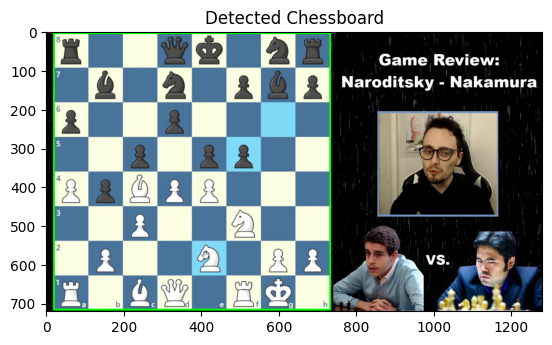

example_frames/u0o38cEaGdw_120.png
Best match value: 0.8178665637969971 at scale: 0.5354430379746836


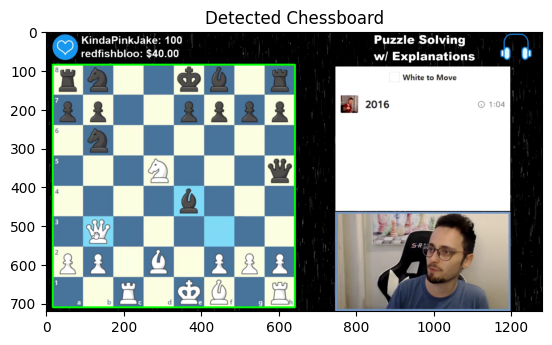

example_frames/Uc7Kf_-hsgw_120.png
Best match value: 0.4809756577014923 at scale: 0.49810126582278486


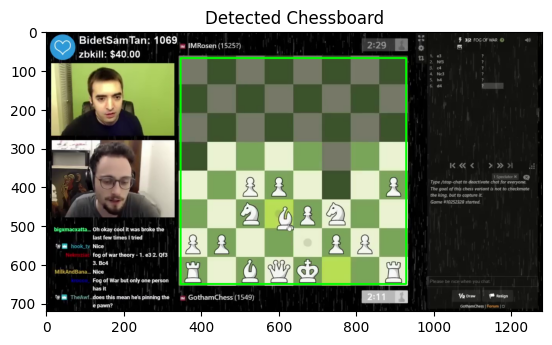

example_frames/65VWIFlc4C4_120.png
Best match value: 0.6058260798454285 at scale: 0.6101265822784812


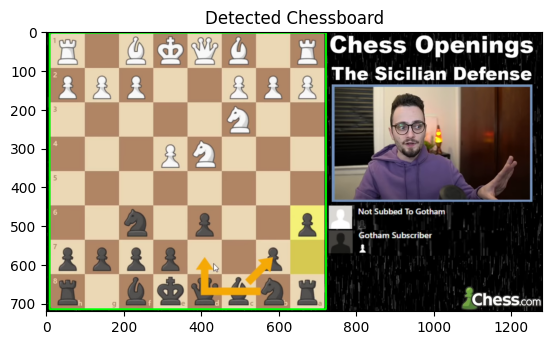

example_frames/NFod-ozimmM_120.png
Best match value: 0.660957932472229 at scale: 0.6101265822784812


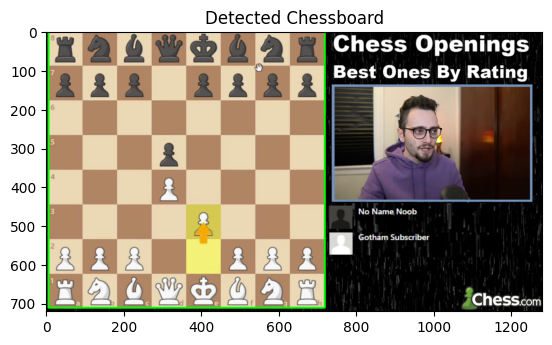

example_frames/-ZVbDR3sRRo_120.png
Best match value: 0.5819105505943298 at scale: 0.6101265822784812


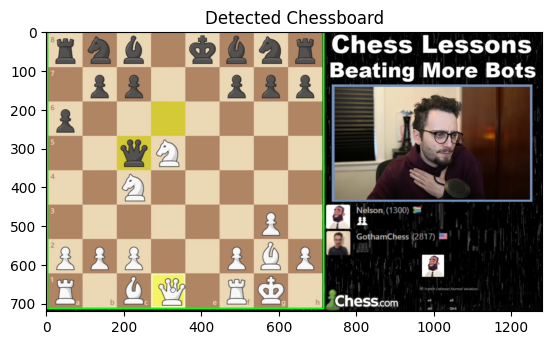

example_frames/9dQzTnvsNG4_120.png
Best match value: 0.578413188457489 at scale: 0.5354430379746836


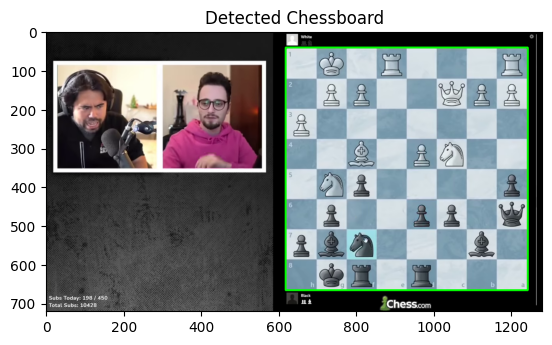

example_frames/PmQs1KhB948_120.png
Best match value: 0.676373302936554 at scale: 0.6101265822784812


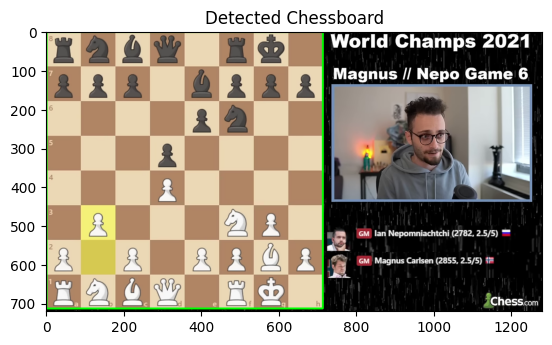

example_frames/ghJRGPXsjfk_120.png
Best match value: 0.6484206914901733 at scale: 0.6101265822784812


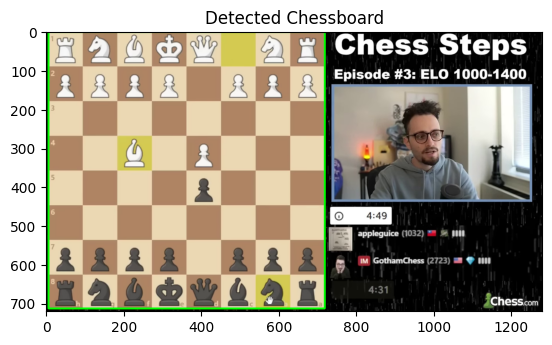

example_frames/_B4lR3NYwI8_120.png
Best match value: 0.5180959701538086 at scale: 0.6101265822784812


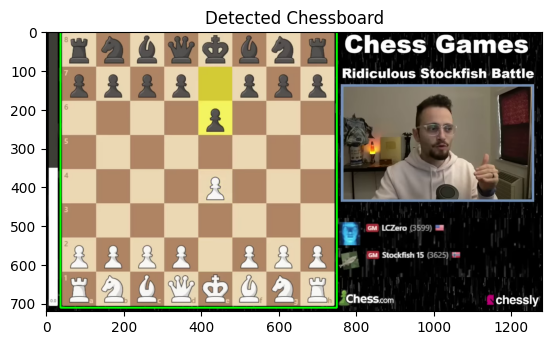

example_frames/QNcO9CJyDBc_120.png
Best match value: 0.6370368599891663 at scale: 0.2740506329113924


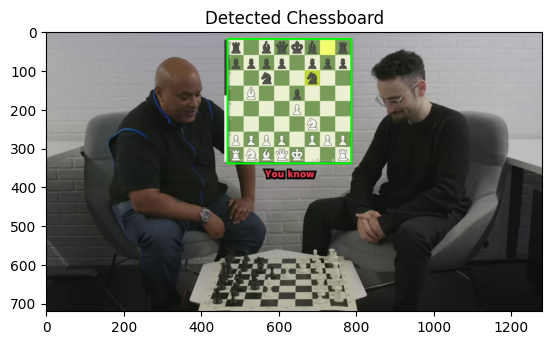

example_frames/3I_ESQVyxNc_120.png
Best match value: 0.6633723378181458 at scale: 0.2740506329113924


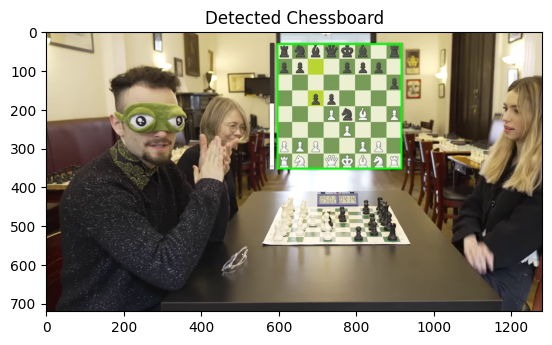

example_frames/Xxqi7IvwekE_120.png
Best match value: 0.5028846859931946 at scale: 0.6101265822784812


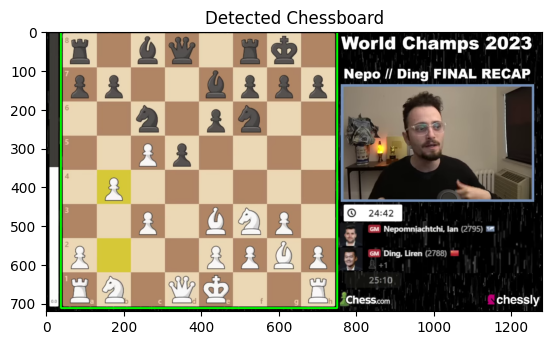

example_frames/r0jMl4qNdyQ_120.png
Best match value: 0.6149173974990845 at scale: 0.5354430379746836


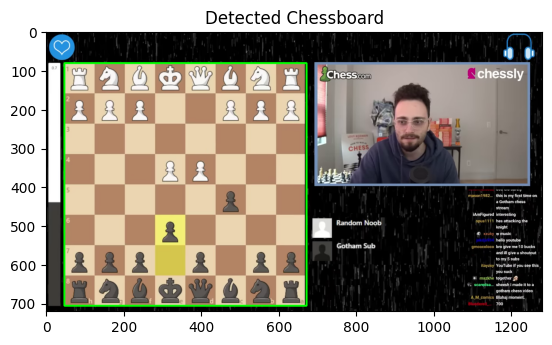

example_frames/CmM1zxS_Ae8_120.png
Best match value: 0.5768658518791199 at scale: 0.6101265822784812


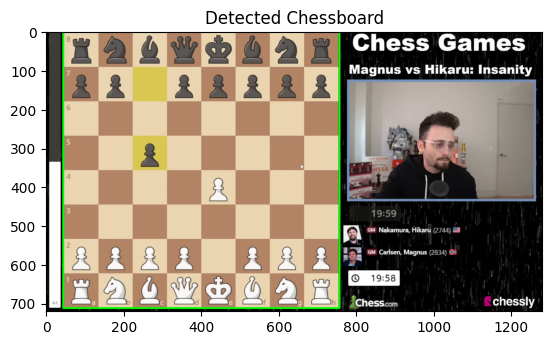

In [6]:
for name in file_names:
    test_image_name = f'{name}_{TIME_IN_SECONDS}.png'
    test_image_path = os.path.join(OUTPUT_FOLDER, test_image_name)
    print(test_image_path)
    template_image_path = 'chessboard.png'
    test_image, template = load_images(test_image_path, template_image_path)

    # Convert both images to grayscale
    test_gray = convert_to_grayscale(test_image)
    template_gray = convert_to_grayscale(template)

    # Multi-scale template matching
    scale_range = np.linspace(0.05, 3, 80)  # Narrow down the scale range
    threshold = 0.3  # Threshold for match quality
    found = match_template(test_gray, template_gray, scale_range, threshold)

    # Visualize the detected chessboard
    visualize_detection(test_image_path, template, found)

In [7]:
def extract_frames(video_path, interval=10):
    # Extract frames from the video every 'interval' seconds
    video_capture = cv2.VideoCapture(video_path)
    frames = []

    if not video_capture.isOpened():
        print(f"Error opening video file: {video_path}")
        return frames

    fps = int(video_capture.get(cv2.CAP_PROP_FPS))
    frame_interval = fps * interval

    total_frames = int(video_capture.get(cv2.CAP_PROP_FRAME_COUNT))
    print(f"Total frames in video: {total_frames}")

    # Loop to extract frames at the specified interval
    current_frame = 0
    while current_frame < total_frames:
        # Set the video position to the desired frame
        video_capture.set(cv2.CAP_PROP_POS_FRAMES, current_frame)

        success, frame = video_capture.read()
        if not success:
            break

        frames.append(frame)
        current_frame += frame_interval

    video_capture.release()
    return frames

In [8]:
# Extract frames from the video every 10 seconds
test_video_path = os.path.join(VIDEO_DOWNLOAD_FOLDER, "QNcO9CJyDBc.mp4")
print(test_video_path)
frames = extract_frames(test_video_path, interval=10)

DownloadedVideos/QNcO9CJyDBc.mp4
Total frames in video: 22581


In [9]:
frames_grayscale = [cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY) for frame in frames]

In [10]:
# Load images
template_image_path = 'chessboard.png'
template = cv2.imread(template_image_path, cv2.IMREAD_COLOR)
template_gray = convert_to_grayscale(template)

# Multi-scale template matching
scale_range = np.linspace(0.05, 2, 80)  # Narrow down the scale range
threshold = 0.5  # Threshold for match quality

# Results
matches = []

for frame in frames_grayscale:
    matches.append(match_template(frame, template_gray, scale_range, threshold))

In [11]:
import numpy as np
import matplotlib.pyplot as plt
import cv2

# Define a function to visualize matches in a grid
def visualize_matches(matches, template, num_columns=3):
    """
    Visualizes the matches in a grid format.

    Parameters:
    - matches: List of tuples containing frames and match information
    - template: The template image used for matching
    - num_columns: Number of columns in the grid visualization
    """
    num_matches = len(matches)
    num_rows = (num_matches + num_columns - 1) // num_columns  # Calculate required rows

    plt.figure(figsize=(num_columns * 5, num_rows * 5))  # Adjust figure size dynamically

    count = 0
    for frame, found in matches:
        if found:
            (max_val, max_loc, best_scale) = found

            # Resize the template to the best scale
            best_template = cv2.resize(template, None, fx=best_scale, fy=best_scale, interpolation=cv2.INTER_AREA)

            # Draw a rectangle around the detected area in the frame
            (top_left_x, top_left_y) = max_loc
            bottom_right_x = top_left_x + best_template.shape[1]
            bottom_right_y = top_left_y + best_template.shape[0]

            copy_frame = frame.copy()
            cv2.rectangle(copy_frame, (top_left_x, top_left_y), (bottom_right_x, bottom_right_y), (0, 255, 0), 3)

            # Display the result in a grid layout
            plt.subplot(num_rows, num_columns, count + 1)
            plt.imshow(cv2.cvtColor(copy_frame, cv2.COLOR_BGR2RGB))
            plt.title(f'Match {count + 1}')
            plt.axis('off')
            count += 1

    plt.tight_layout()
    plt.show()


In [12]:
matches

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 (0.6792248487472534, (469, 21), 0.2721518987341772),
 (0.6753201484680176, (469, 21), 0.2721518987341772),
 (0.6672752499580383, (469, 21), 0.2721518987341772),
 (0.6784074306488037, (469, 21), 0.2721518987341772),
 (0.6922376155853271, (469, 21), 0.2721518987341772),
 (0.6941611766815186, (469, 21), 0.2721518987341772),
 (0.6816901564598083, (469, 21), 0.2721518987341772),
 (0.7041300535202026, (469, 21), 0.2721518987341772),
 (0.7069960236549377, (469, 21), 0.2721518987341772),
 None,
 None,
 None,
 None,
 (0.7173972725868225, (469, 21), 0.2721518987341772),
 None,
 None,
 None,
 (0.7065033912658691, (469, 21), 0.2721518987341772),
 (0.7061956524848938, (469, 21), 0.2721518987341772),
 (0.7038497924804688, (469, 21), 0.2721518987341772),
 (0.7172054052352905, (469, 21), 0.2721518987341772),
 (0.7166546583175659, (469, 21), 0.2721518987341772),
 (0.7360303997993469, (469, 21), 0.2721518987341772),
 (0.7355949282646179, (469, 21)

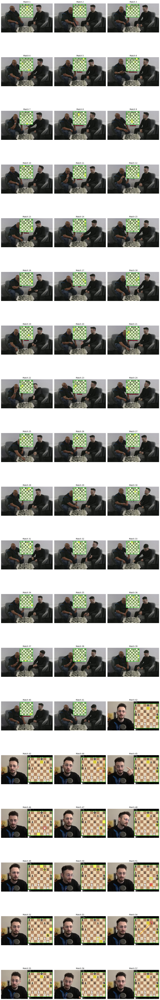

In [13]:
visualize_matches(list(zip(frames, matches)), template, num_columns=3)

In [14]:
def crop_chessboard(image, match_dimensions):
    return image[match_dimensions[0]:match_dimensions[1], match_dimensions[2]:match_dimensions[3]]

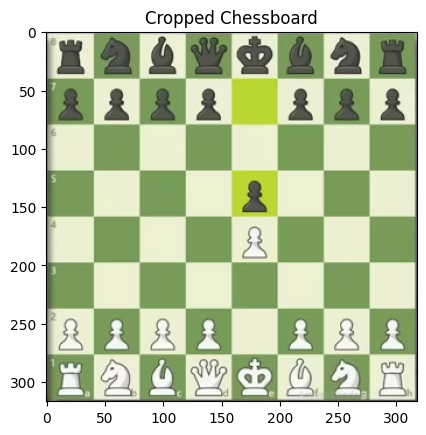

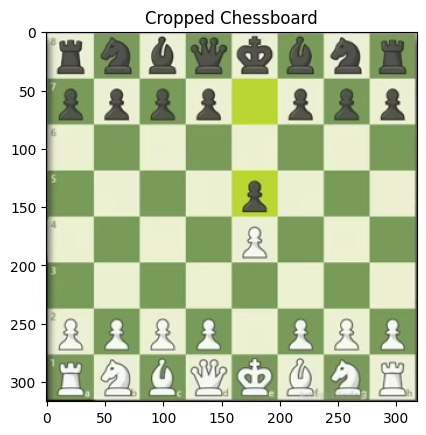

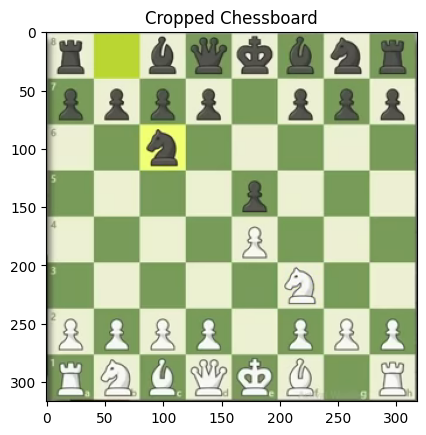

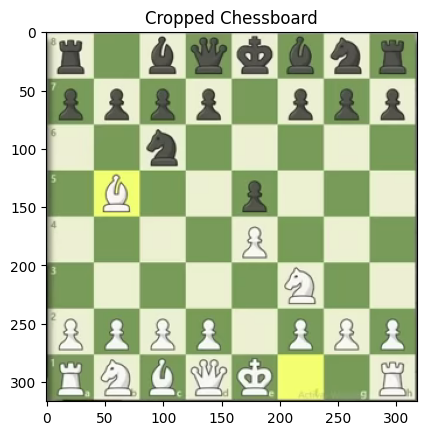

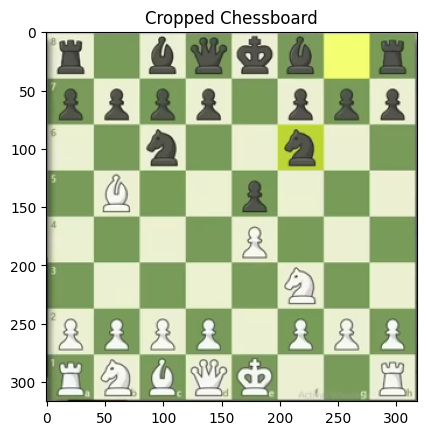

...

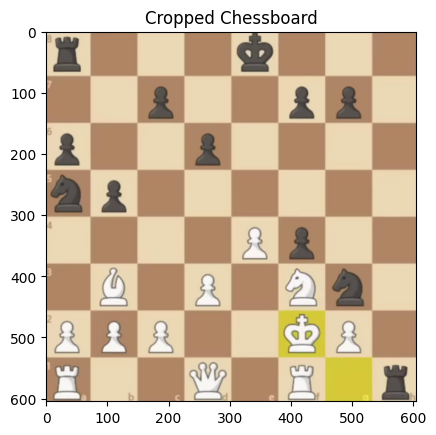

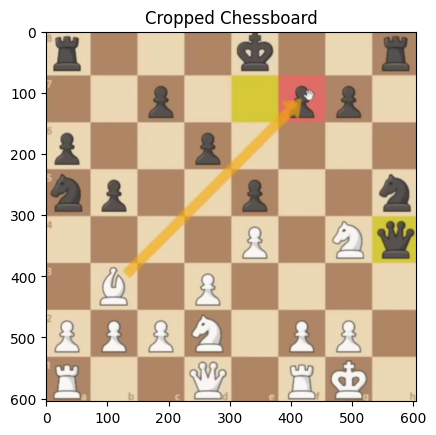

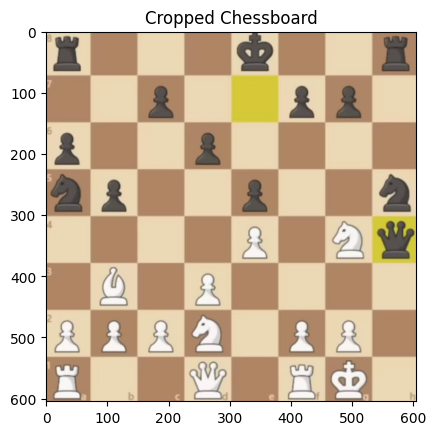

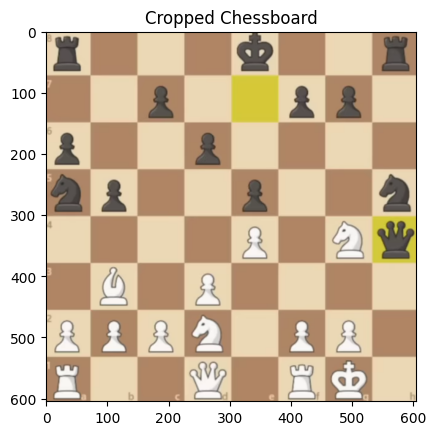

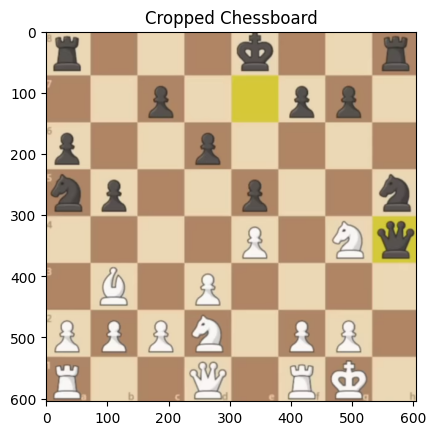

In [15]:
detected_boards = []

for frame, found in list(zip(frames, matches)):
    if found:
        (max_val, max_loc, best_scale) = found

        # Resize the template to the best scale
        best_template = cv2.resize(template, None, fx=best_scale, fy=best_scale, interpolation=cv2.INTER_AREA)

        # Draw a rectangle around the detected area in the frame
        (top_left_x, top_left_y) = max_loc
        bottom_right_x = top_left_x + best_template.shape[1]
        bottom_right_y = top_left_y + best_template.shape[0]

        # Display the result in a grid layout
        cropped_frame = crop_chessboard(frame, (top_left_y, bottom_right_y, top_left_x, bottom_right_x))
        detected_boards.append(cropped_frame)

        # Display the result
        plt.imshow(cv2.cvtColor(cropped_frame, cv2.COLOR_BGR2RGB))
        plt.title('Cropped Chessboard')
        plt.show()

In [16]:
def divide_chessboard(image):
    height, width, _ = image.shape

    square_height = height // 8
    square_width = width // 8

    for row in range(8):
        for col in range(8):
            x1 = col * square_width
            x2 = (col + 1) * square_width
            y1 = row * square_height
            y2 = (row + 1) * square_height

            square = image[y1:y2, x1:x2]
            plt.imshow(cv2.cvtColor(square, cv2.COLOR_BGR2RGB))
            plt.title(f'Square {row * 8 + col + 1}')
            plt.show()

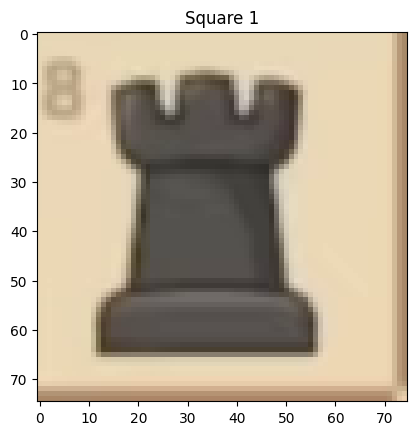

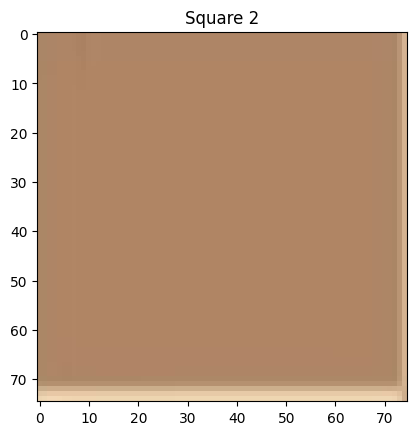

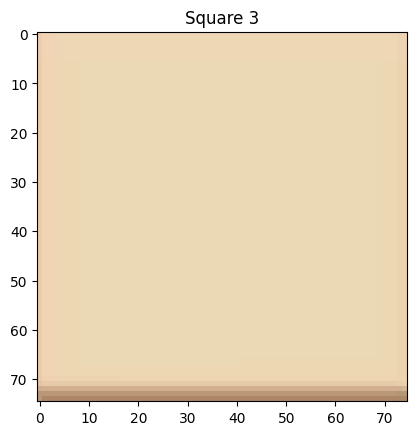

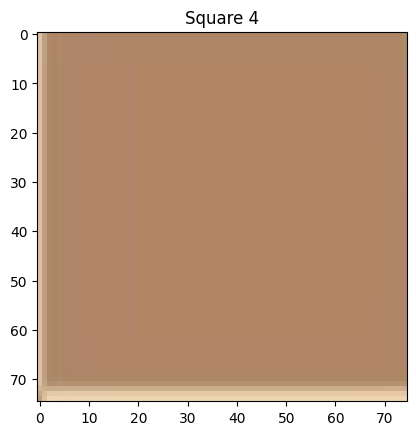

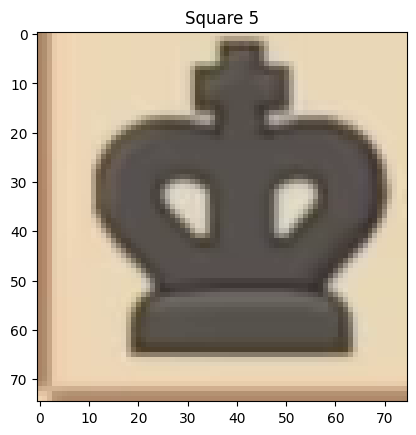

...

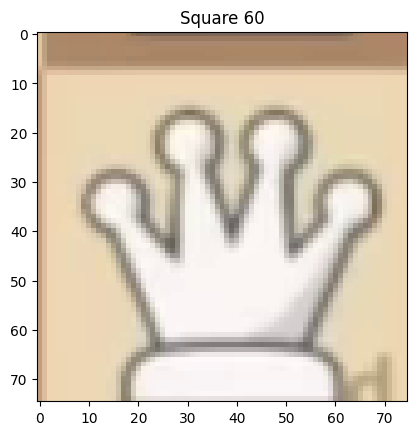

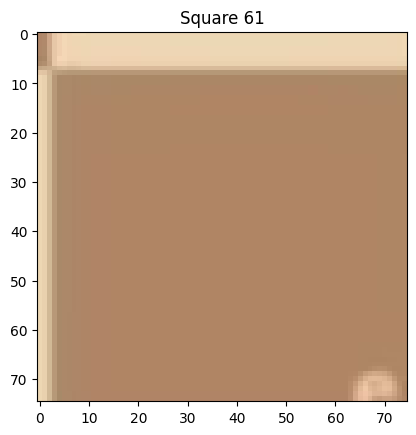

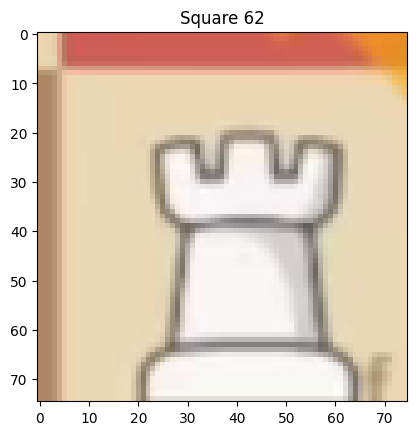

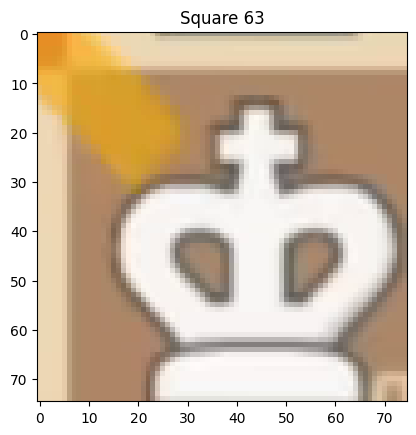

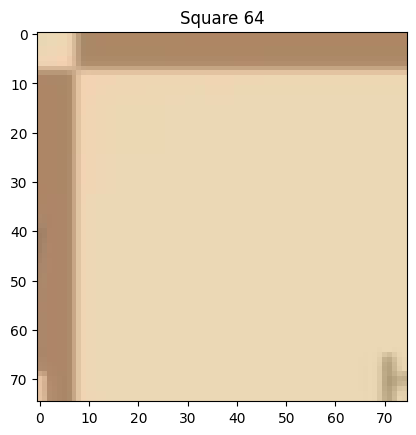

In [17]:
divide_chessboard(detected_boards[50])